# Оценки отелей на Booking

Представьте, что вы работаете датасаентистом в компании Booking. Одна из проблем компании — это нечестные отели, которые накручивают себе рейтинг. Одним из способов нахождения таких отелей является построение модели, которая предсказывает рейтинг отеля. Если предсказания модели сильно отличаются от фактического результата, то, возможно, отель играет нечестно, и его стоит проверить.

   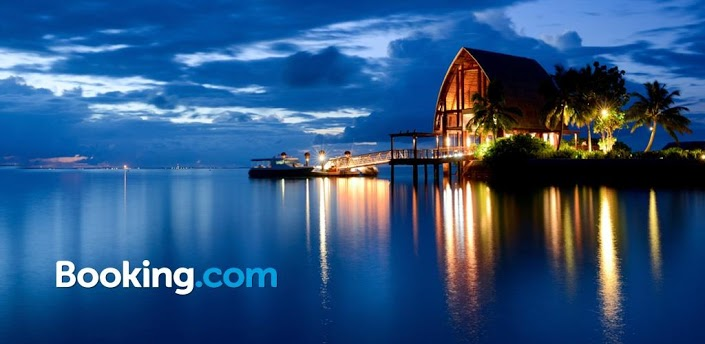

## Подготовка и чтение данных

In [1]:
%%capture

# QUICK WORKAROUND FOR PROBLEM WITH PANDAS
!pip install -U pandas

!pip install twython 

!pip install xlrd

In [2]:
# Standard python libraries
import os
import time

# Essential DS libraries
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import category_encoders as ce
import torch
from geopy.distance import geodesic
from geopy.geocoders import Nominatim
from sklearn.metrics import mean_absolute_error
from sklearn.model_selection import train_test_split
from sklearn.feature_selection import f_classif
from sklearn.ensemble import RandomForestRegressor # инструмент для создания и обучения модели
from sklearn import metrics # инструменты для оценки точности модели

# импортируем библиотеки для визуализации
import matplotlib.pyplot as plt
import seaborn as sns 
import plotly.express as px
%matplotlib inline

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))


/kaggle/input/sf-booking/hotels_test.csv
/kaggle/input/sf-booking/hotels_train.csv
/kaggle/input/sf-booking/submission.csv
/kaggle/input/hotels-stars/Paris.xls
/kaggle/input/hotels-stars/Barcelona.xls
/kaggle/input/hotels-stars/London.xls
/kaggle/input/hotels-stars/Milan.xls
/kaggle/input/hotels-stars/Amsterdam.xls
/kaggle/input/hotels-stars/Vienna.xls


In [3]:
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)

In [4]:
# всегда фиксируйте RANDOM_SEED, чтобы ваши эксперименты были воспроизводимы!
RANDOM_SEED = 42

In [5]:
# зафиксируем версию пакетов, чтобы эксперименты были воспроизводимы:
!pip freeze > requirements.txt

In [6]:
# Подгрузим наши данные из соревнования

DATA_DIR = '/kaggle/input/sf-booking/'
df_train = pd.read_csv(DATA_DIR+'/hotels_train.csv') # датасет для обучения
df_test = pd.read_csv(DATA_DIR+'hotels_test.csv') # датасет для предсказания
sample_submission = pd.read_csv(DATA_DIR+'/submission.csv') # самбмишн

In [7]:
sample_submission.head(2)

,reviewer_score,id
0,1,488440
1,10,274649


In [8]:
sample_submission.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 128935 entries, 0 to 128934
Data columns (total 2 columns):
 #   Column          Non-Null Count   Dtype
---  ------          --------------   -----
 0   reviewer_score  128935 non-null  int64
 1   id              128935 non-null  int64
dtypes: int64(2)
memory usage: 2.0 MB


In [9]:
# ВАЖНО! дря корректной обработки признаков объединяем трейн и тест в один датасет
df_train['sample'] = 1 # помечаем где у нас трейн
df_test['sample'] = 0 # помечаем где у нас тест
df_test['reviewer_score'] = 0 # в тесте у нас нет значения reviewer_score, мы его должны предсказать, по этому пока просто заполняем нулями

hotels = df_test.append(df_train, sort=False).reset_index(drop=True) # объединяем

In [10]:
hotels.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 515738 entries, 0 to 515737
Data columns (total 18 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   hotel_address                               515738 non-null  object 
 1   additional_number_of_scoring                515738 non-null  int64  
 2   review_date                                 515738 non-null  object 
 3   average_score                               515738 non-null  float64
 4   hotel_name                                  515738 non-null  object 
 5   reviewer_nationality                        515738 non-null  object 
 6   negative_review                             515738 non-null  object 
 7   review_total_negative_word_counts           515738 non-null  int64  
 8   total_number_of_reviews                     515738 non-null  int64  
 9   positive_review                             515738 non-null  object 
 

In [11]:
hotels.head(2)

,hotel_address,additional_number_of_scoring,review_date,average_score,hotel_name,reviewer_nationality,negative_review,review_total_negative_word_counts,total_number_of_reviews,positive_review,review_total_positive_word_counts,total_number_of_reviews_reviewer_has_given,tags,days_since_review,lat,lng,sample,reviewer_score
0,Via Senigallia 6 20161 Milan Italy,904,7/21/2017,8.1,Hotel Da Vinci,United Kingdom,Would have appreciated a shop in the hotel th...,52,16670,Hotel was great clean friendly staff free bre...,62,1,"[' Leisure trip ', ' Couple ', ' Double Room '...",13 days,45.533137,9.171102,0,0.0
1,Arlandaweg 10 Westpoort 1043 EW Amsterdam Neth...,612,12/12/2016,8.6,Urban Lodge Hotel,Belgium,No tissue paper box was present at the room,10,5018,No Positive,0,7,"[' Leisure trip ', ' Group ', ' Triple Room ',...",234 day,52.385649,4.834443,0,0.0


Признаки:
* **hotel_address** — адрес отеля;
* **review_date** — дата, когда рецензент разместил соответствующий отзыв;
* **average_score** — средний балл отеля, рассчитанный на основе последнего комментария за последний год;
* **hotel_name** — название отеля;
* **reviewer_nationality** — страна рецензента;
* **negative_review** — отрицательный отзыв, который рецензент дал отелю;
* **review_total_negative_word_counts** — общее количество слов в отрицательном отзыв;
* **positive_review** — положительный отзыв, который рецензент дал отелю;
* **review_total_positive_word_counts** — общее количество слов в положительном отзыве.
* **reviewer_score** — оценка, которую рецензент поставил отелю на основе своего опыта;
* **total_number_of_reviews_reviewer_has_given** — количество отзывов, которые рецензенты дали в прошлом;
* **total_number_of_reviews** — общее количество действительных отзывов об отеле;
* **tags** — теги, которые рецензент дал отелю;
* **days_since_review** — количество дней между датой проверки и датой очистки;
* **additional_number_of_scoring** — есть также некоторые гости, которые просто поставили оценку сервису, но не оставили отзыв. Это число указывает, сколько там действительных оценок без проверки.
* **lat** — географическая широта отеля;
* **lng** — географическая долгота отеля.

## Объявление функций

In [12]:
# creating function  to make this columns easier to visualize
def creating_heatmap(df, values, columns, aggfunc='mean'):
    """This function create heatmap of main dataset.
    Args:
        name of column (str)
    Returns:
        heatmap graph
    """
    
    pivot_table = df[df['sample']==1].pivot_table(values=values, columns=columns, aggfunc=aggfunc)
    pivot_table.columns = pivot_table.columns.astype('string')
    fig, ax = plt.subplots(figsize=(20,4))    
    heatmap = sns.heatmap(data=pivot_table, cbar_kws={'label': values})
    heatmap.set_title('Reviewer score depending on ' + values, fontsize=15, fontweight='bold', pad=20);
    heatmap.set_xlabel('reviewer scores of hotels');
    
    return heatmap

In [13]:
def creating_bar(df, columns, value):
    df_grouped = df[df['sample']==1].groupby(columns, as_index=False)[value].mean()
    fig = px.bar(
        data_frame=df_grouped,
        x=columns,
        y=value,
        title=f'Взаимосвязь признака {columns} и признака {value}',
        color=columns,
        color_discrete_sequence=px.colors.qualitative.Bold,
        width=1000
    )
    fig.show()

In [14]:
def creating_scatter(df, columns, value):
    fig = px.scatter(
        data_frame=df[df['sample']==1], 
        x = columns,
        y = value, 
        width=1000,
        height=700,
        title=f'Взаимосвязь признака {columns} и признака {value}',
    )
    fig.add_scatter(
        mode='lines',
        showlegend=False
    )
    fig.show()

## Генерация признаков

### Расположение отеля

Видим, что адреса отелей (признак *hotel_address*) имеют схожую структуру. 

Можем выделить город и страну

In [15]:
hotels['country'] = hotels['hotel_address'].apply(
    lambda x: x.split()[-1] 
        if x.split()[-1] != 'Kingdom'
        else ' '.join(x.split()[-2:])
)
    
hotels['city'] = hotels.apply(
    lambda x: x['hotel_address'].split()[-5] 
        if x['country'] == 'United Kingdom'
        else x['hotel_address'].split()[-2], axis=1
)

In [16]:
display(hotels[['country', 'city']].value_counts())

country         city     
United Kingdom  London       262301
Spain           Barcelona     60149
France          Paris         59928
Netherlands     Amsterdam     57214
Austria         Vienna        38939
Italy           Milan         37207
dtype: int64

В выборке представлено всего 6 стран и 6 городов (по одному городу в стране).

Тогда нам достаточно одного признака. Будем ориентироваться на город.


По городу можем получить информацию о населении и расстоянию до центра города.

Так как значений мало, можем вручную составить таблицу с данными городов. А также закодировать город через OneHotEncoding.

In [17]:
population_df = pd.DataFrame(
    [
        ['London', 8.982, 51.50735, -0.12776], 
        ['Barcelona', 1.62, 41.3888, 2.15899], 
        ['Paris', 2.161, 48.85661, 2.35222], 
        ['Amsterdam', 0.822, 52.37022, 4.89517], 
        ['Vienna', 1.897, 48.20817, 16.37382], 
        ['Milan', 1.352, 45.45863, 9.18187]
    ], 
    columns=['city', 'city_population', 'center_lat', 'center_lng']
)
hotels = hotels.merge(population_df, how='left', on='city')

In [18]:
encoder = ce.OneHotEncoder(cols=['city']) # указываем столбец для кодирования
type_bin = encoder.fit_transform(hotels['city'])
type_bin = type_bin.rename(columns={'city_1':'London','city_2':'Paris','city_3':'Amsterdam','city_4':'Milan','city_5':'Vienna','city_6':'Barcelona'})
hotels = pd.concat([hotels, type_bin], axis=1)

Как мы видели ранее, в координатах отелей есть пропуски (признаки *lat* и *lng*). Это помешает нам корректно рассчитать расстояние до центра города.


Однако можем попробовать получить координаты по адресу отеля (признак *hotel_address*). Если по адресу получить не удастся, попробуем получить по индексу и городу (индекс охватывает примерно $0.5 км^2$, примем такую погрешность).

А затем рассчитаем расстояние от центра до отеля.

Т.к. соединять таблицы будем в т.ч. по наименованию отеля, нужно добиться, чтобы наименования были уникальны.

In [19]:
# соединим название города и название отеля (для случаев, когда сеть отелей представлена в разных городах)
hotels['hotel_name'] = hotels.apply(lambda x: ' '.join([x.hotel_name, x.city]), axis=1)

In [20]:
hotels.groupby(['hotel_name', 'hotel_address'], as_index=False).count().hotel_name.value_counts()[:10]

11 Cadogan Gardens London                                1
Mercure Paris Gare De Lyon TGV Paris                     1
Mercure Paris Opera Louvre Paris                         1
Mercure Paris Opera Grands Boulevards Paris              1
Mercure Paris Opera Garnier Paris                        1
Mercure Paris Op ra Faubourg Montmartre Paris            1
Mercure Paris Notre Dame Saint Germain des Pr s Paris    1
Mercure Paris Montparnasse Raspail Paris                 1
Mercure Paris Montmartre Sacr Coeur Paris                1
Mercure Paris Gobelins Place d Italie Paris              1
Name: hotel_name, dtype: int64

In [21]:
# определим координаты по адресу там, где они пропущены
geolocator = Nominatim(user_agent="Tester")
df_empty_lat = hotels[pd.isna(hotels['lat'])].groupby(
    ['hotel_name', 'hotel_address'],
    as_index=False
)[['lat', 'lng']].sum()
for ind, row in df_empty_lat.iterrows():
    address = row['hotel_address']
    location = geolocator.geocode(address)
    if not location:
        address_index = ' '.join(address.split()[-3:])
        location = geolocator.geocode(address_index)
    if location:
        df_empty_lat.loc[ind, 'lat'] = location.latitude
        df_empty_lat.loc[ind, 'lng'] = location.longitude

df_empty_lat.drop(['hotel_address'], axis=1, inplace=True)   
hotels = hotels.merge(df_empty_lat, how='left', on='hotel_name', suffixes=('', '_geo'))
hotels.loc[pd.isna(hotels['lat']), 'lat'] = hotels['lat_geo']
hotels.loc[pd.isna(hotels['lng']), 'lng'] = hotels['lng_geo']
hotels.drop(['lat_geo', 'lng_geo'], axis=1, inplace=True)   

In [22]:
# рассчитаем расстояние до центра города
df_hotels_grouped = hotels.groupby(['hotel_name'], as_index=False)[['lat', 'lng', 'center_lat', 'center_lng']].max()
df_hotels_grouped['center_distance'] = df_hotels_grouped.apply(lambda x: geodesic((x.lat, x.lng), (x.center_lat, x.center_lng), ellipsoid='WGS-84').km, axis=1)
df_hotels_grouped.drop(['lat', 'lng', 'center_lat', 'center_lng'], axis=1, inplace=True)
hotels = hotels.merge(df_hotels_grouped, how='left', on='hotel_name')
hotels.drop(['center_lat', 'center_lng', 'lat', 'lng'], axis=1, inplace=True)   

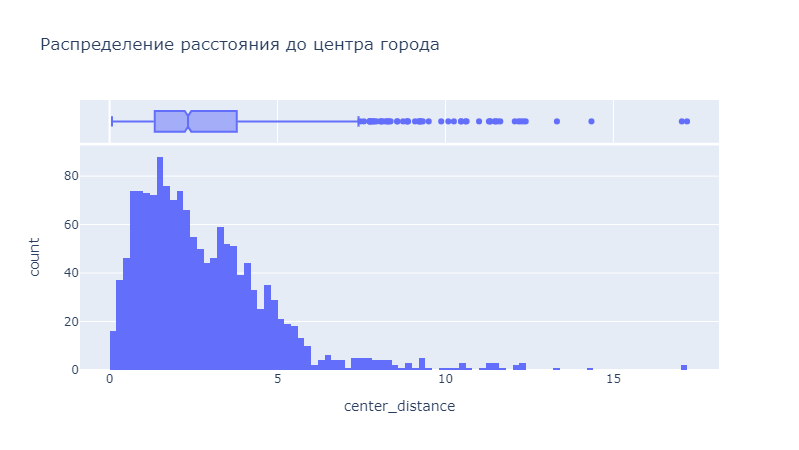

In [23]:
# построим гистограмму распределения расстояния до центра города
fig = px.histogram(
    data_frame=hotels.groupby('hotel_name', as_index=False).center_distance.min(),
    x='center_distance',
    title='Распределение расстояния до центра города',
    nbins=90,
    marginal='box',
    width=1000,
)
fig.show()

Распределение расстояний до центра в разрезе отелей (не отзывов) похоже на нормальное. 

Имеются всплески в районе 1 км и 3.5 км. Также есть значения, похожие на выбросы (>13 км). 

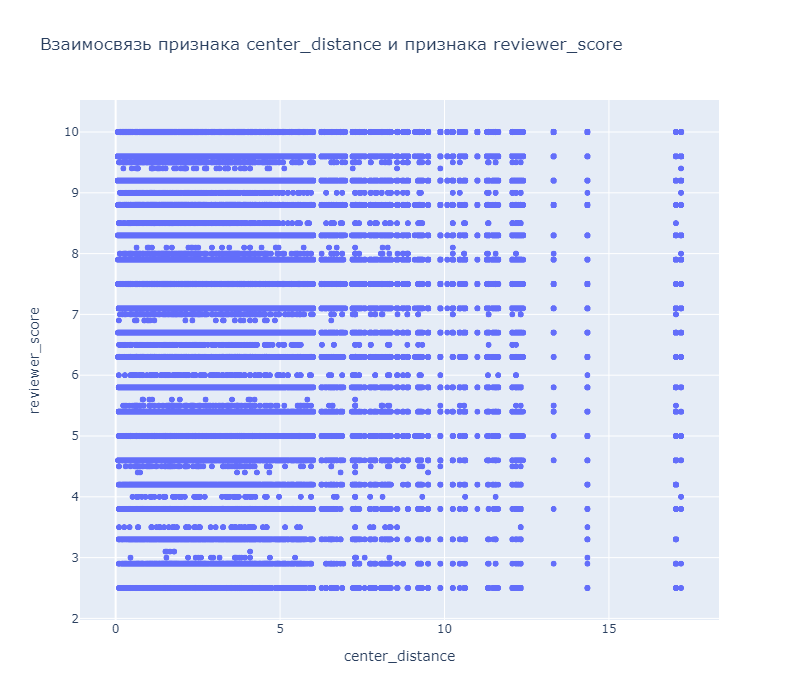

In [24]:
creating_scatter(hotels, 'center_distance', 'reviewer_score')

Особой взаимосвязи на графике не видно

Подгрузим файлы Excel с характеристиками отелей, полученные из внешних источников.

Нас будут интересовать колонки *stars* (количество звезд отелей) и *to_center* (порядковый признак, характеризующий расположение отеля. Учитывает не только расстояние до центра, но и близость к морю для пляжных отелей).

Для части отелей наименования не будут найдены при поиске по равенству. Попробуем поискать с помощью специальной библиотеки по степени сходства.

Как увидим далее, эти признаки не оказывают существенного влияния на модель. Поэтому сопоставление названий отелей производилось с допущением, что для некоторых отелей могли быть найдены не совсем корректные пары, чтобы не тратить много времени.

In [25]:
from fuzzywuzzy import fuzz as f 
from fuzzywuzzy import process as p

DATA_DIR_STARS = '/kaggle/input/hotels-stars/'

def change_hotel_name(name):
    lower_name = name.lower()
    str_replace = [
        'the ', 'hotel', 'amsterdam', 'vienna', 'by sofitel', 'by marriott', 'barcelona', 'milano', 'london', 'paris', 'by hilton', 'by elegancia', 
        'by breedgestreet', 'by happyculture', 'boutique', "'s", '-', ',', '/', 'wien', 'h tel', 'residence',' rooms', 'suites', 'a hilton',' by ', ' s '
    ]
    for word in str_replace:
        lower_name = lower_name.replace(word, ' ')
        
    return lower_name.replace('  ','').replace('  ','').replace('  ','').strip()

def find_hotel(row):
    lower_name = row.hotel_name_lower
    len_lower_name = len(lower_name)
    if len_lower_name == 0:
        return -1, -1
    for index, stars_row in hotel_stars_df[hotel_stars_df['city']==city].iterrows():
        stars_row_name = stars_row.hotel_name_lower
        len_stars_row_name = len(stars_row_name)
        if len_stars_row_name == 0:
            continue
        coef = len_stars_row_name/len_lower_name
        if f.WRatio(stars_row_name, lower_name) > 70 and coef > 0.60 and 1/coef > 0.60:
            return stars_row.stars, stars_row.to_center
    return -1, -1

hotels_grouped = hotels.groupby(['hotel_name', 'city'], as_index=False).reviewer_score.max()
hotels_grouped['hotel_name_lower'] = hotels_grouped['hotel_name'].apply(change_hotel_name)

hotel_stars_amsterdam = pd.read_excel(DATA_DIR_STARS +'Amsterdam.xls')
hotel_stars_amsterdam['city'] = 'Amsterdam'
hotel_stars_vienna = pd.read_excel(DATA_DIR_STARS +'Vienna.xls')
hotel_stars_vienna['city'] = 'Vienna'
hotel_stars_barcelona = pd.read_excel(DATA_DIR_STARS +'Barcelona.xls')
hotel_stars_barcelona['city'] = 'Barcelona'
hotel_stars_milan = pd.read_excel(DATA_DIR_STARS +'Milan.xls')
hotel_stars_milan['city'] = 'Milan'
hotel_stars_paris = pd.read_excel(DATA_DIR_STARS +'Paris.xls')
hotel_stars_paris['city'] = 'Paris'
hotel_stars_london = pd.read_excel(DATA_DIR_STARS +'London.xls')
hotel_stars_london['city'] = 'London'
hotel_stars_df = pd.concat([
    hotel_stars_amsterdam,
    hotel_stars_vienna,
    hotel_stars_barcelona,
    hotel_stars_milan,
    hotel_stars_paris,
    hotel_stars_london
])

hotel_stars_df['hotel_name_lower'] = hotel_stars_df['hotel_name'].apply(change_hotel_name)
hotel_stars_df.drop(['hotel_name'], axis=1, inplace=True);
hotel_stars_df = hotel_stars_df.groupby(['hotel_name_lower', 'city'], as_index=False).max()

hotels_grouped = hotels_grouped.merge(hotel_stars_df, how='left', on=['hotel_name_lower', 'city'], suffixes=('', '_top'))
hotel_stars_df_to_del = hotel_stars_df.merge(hotels_grouped, how='inner', on=['hotel_name_lower', 'city'], suffixes=('', '_ff'))
hotel_stars_df = hotel_stars_df.merge(hotel_stars_df_to_del, how='left', on=['hotel_name_lower', 'city'], suffixes=('', '_del'))
hotel_stars_df.drop(index = hotel_stars_df[~pd.isna(hotel_stars_df['stars_del'])].index, inplace=True)
print('all ', hotels_grouped[pd.isna(hotels_grouped['stars'])].shape[0])

cities = list(hotel_stars_df.city.unique())
for city in cities:
    print(city)
    for ind, row in hotels_grouped.iterrows():
        if pd.isna(row.stars) and row.city == city:
            stars, to_center = find_hotel(row)
            if stars != -1:
                hotels_grouped.loc[ind,'stars'] = stars
                hotels_grouped.loc[ind,'to_center'] = to_center

hotels = hotels.merge(hotels_grouped, how='left', on=['hotel_name', 'city'], suffixes=('', '_top'))
hotels.loc[hotels['stars'] == -1, 'stars'] = hotels.stars.median()
hotels.loc[hotels['to_center'] == -1, 'to_center'] = hotels.to_center.median()
hotels.drop(['reviewer_score_top'], axis=1, inplace=True);

all  698
Amsterdam
Milan
Paris
Vienna
Barcelona
London


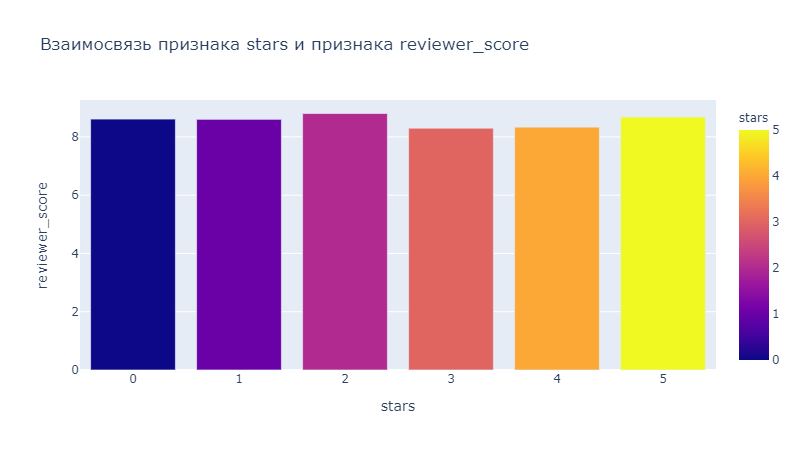

In [26]:
creating_bar(hotels, 'stars', 'reviewer_score')

Особой взаимосвязи между количеством звезд гостиницы и оценкой на графике не видно.

### Дата отзыва

Получим дополнительную информацию из даты отзыва (*review_date*). А также преобразуем к числу количество дней с момента получения отзыва (*days_since_review*).

Номер месяца и день недели закодируем с помощью OneHotEncoding, т.к. это не порядковые данные

In [27]:
hotels['review_month'] = pd.to_datetime(hotels['review_date']).dt.month
hotels['review_week_day'] = pd.to_datetime(hotels['review_date']).dt.day_of_week

hotels['days_since_review'] = hotels['days_since_review'].str.replace('days', '').str.replace('day', '').astype('int32')

In [28]:
# кодируем месяц
encoder = ce.OneHotEncoder(cols=['review_month'])
type_bin = encoder.fit_transform(hotels['review_month'])
hotels = pd.concat([hotels, type_bin], axis=1)

In [29]:
# кодируем день недели
encoder = ce.OneHotEncoder(cols=['review_week_day'])
type_bin = encoder.fit_transform(hotels['review_week_day'])
hotels = pd.concat([hotels, type_bin], axis=1)

<AxesSubplot:title={'center':'Reviewer score depending on reviewer_score'}, xlabel='reviewer scores of hotels'>

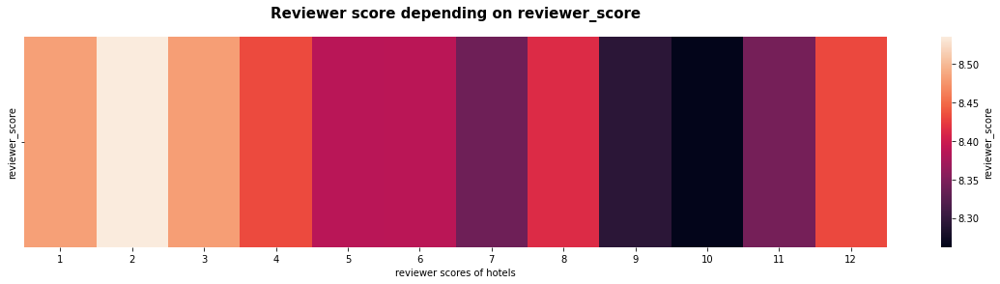

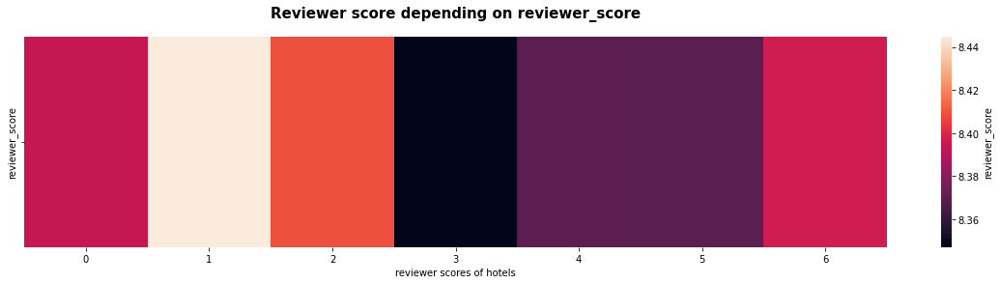

In [30]:
creating_heatmap(hotels, 'reviewer_score', 'review_month')
creating_heatmap(hotels, 'reviewer_score', 'review_week_day')

При анализе месяцев самые низкие оценки в октябре, а самые высокие в феврале. При анализе дня недели самые низкие оценки по средам, а самые высокие в понедельник. 

Но разброс оценок по месяцам и неделям (8.3-8.5) не очень велик, поэтому вряд ли месяц и день недели окажут существенное влияние на оценку.

### Национальность ревьюера

Проверим, сколько национальностей представлено в выборке

In [31]:
hotels['reviewer_nationality'].nunique()

227

In [32]:
hotels['reviewer_nationality'].value_counts()

 United Kingdom               245246
 United States of America      35437
 Australia                     21686
 Ireland                       14827
 United Arab Emirates          10235
                               ...  
 Comoros                           1
 Anguilla                          1
 Tuvalu                            1
 Cape Verde                        1
 Palau                             1
Name: reviewer_nationality, Length: 227, dtype: int64

Значений очень много, поэтому будем использовать бинарное кодирование. Т.к. представителей некоторых национальностей совсем мало, возьмем только первые 150 по кол-ву, остальных отнесем к прочим.

Также посчитаем, представители какого количества национальностей посетили каждый из отелей.

In [33]:
# кодируем национальность ревьюера
unique_nationality = hotels['reviewer_nationality'].value_counts().nlargest(150).index
hotels['reviewer_nationality_grouped'] = hotels['reviewer_nationality'].apply(lambda x: x if x in unique_nationality else 'Other')

bin_encoder = ce.BinaryEncoder(cols=['reviewer_nationality_grouped']) 
type_bin = bin_encoder.fit_transform(hotels['reviewer_nationality_grouped'])
hotels = pd.concat([hotels, type_bin], axis=1)

In [34]:
# считаем общее кол-во национальностей ревьюеров для каждого отеля
nationality_df = hotels.groupby('hotel_name', as_index=False)['reviewer_nationality'].nunique()
nationality_df = nationality_df.rename(columns={'reviewer_nationality': 'reviewer_nationality_count'})
hotels = hotels.merge(nationality_df, how='left', on='hotel_name')

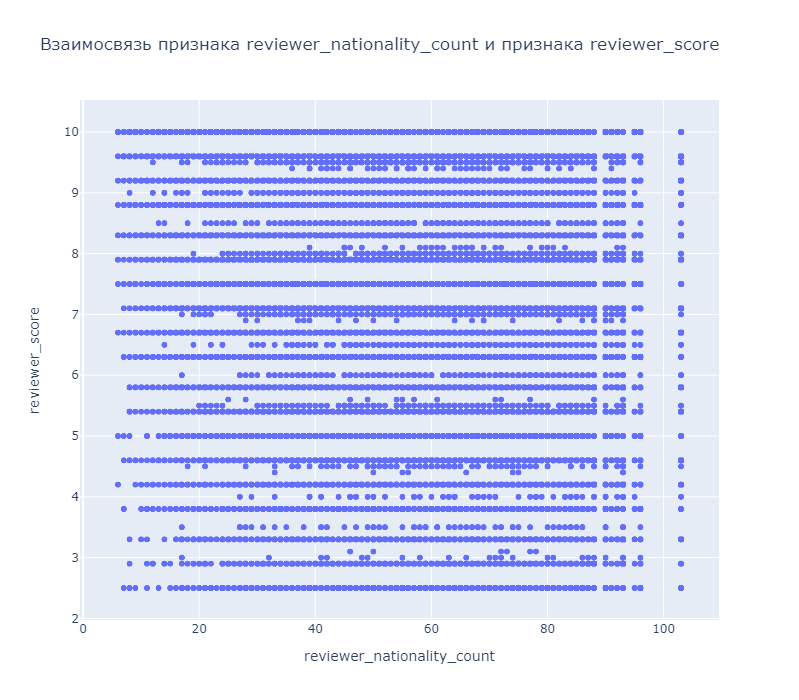

In [35]:
creating_scatter(hotels, 'reviewer_nationality_count', 'reviewer_score')

Особой зависимости между количеством разных национальностей и оценкой не наблюдается

### Тексты отзывов

В данных есть 2 категориальных признака с текстами отзывов (*positive_review* и *negative_review*).

Попробуем получить из текста дополнительную информацию для построения модели.

Для корректного анализа нужно учесть, что:
* есть отрицательные отзывы, в которых указано, что все хорошо (ничего плохого);
* есть положительные отзывы, в которых указано, что все плохо (ничего хорошего).

Попробуем предварительно обработать тексты отзывов и пересчитать количество слов в отзывах (будем считать кол-во слов в таких отзывах равным 0).

In [36]:
hotels[(hotels['sample'] == 1) & (hotels['review_total_negative_word_counts'] > 0) & (hotels['reviewer_score'] > 9)].negative_review.value_counts()[:19]

 Nothing               9356
 Nothing               2846
 nothing               1384
 N A                    688
 None                   596
                        460
 N a                    323
 nothing                193
 All good               192
 none                   182
 Nothing really         167
 Nil                    160
 No complaints          159
 n a                    152
 Nothing really         148
 Nothing at all         144
 Nothing at all         131
 Nothing to dislike     128
 None                   112
Name: negative_review, dtype: int64

In [37]:
hotels[(hotels['sample'] == 1) & (hotels['review_total_positive_word_counts'] > 0) & (hotels['reviewer_score'] < 5)].positive_review.value_counts()[:19]

 Location             851
 Nothing              825
 location             178
 The location         159
 Nothing              155
 nothing              137
 Location              99
 Good location         77
 Breakfast             59
 Not much              47
 Location only         37
 Location was good     35
 Good location         31
 Only the location     31
 Not a lot             29
 The location          29
 Nothing at all        28
 Location is good      22
 Great location        20
Name: positive_review, dtype: int64

Добавим часть перечисленных выше отзывов в исключения

In [38]:
def clear_empty_review(x, list_empty_words_eq, list_empty_words):
    striped_x = x.strip()
    lower_x = striped_x.lower()
    for word in list_empty_words_eq:
        if lower_x == word:
            return ''
    for word in list_empty_words:
        if lower_x.startswith(word):
            return ''
    return lower_x

def clear_negative_review(x):
    list_empty_words_eq = ['n a', 'non', 'no negative', 'none', 'all good', 'everything was perfect', 'everything was great',
                        'everything was good', 'na', 'i liked everything', 'no complaints', 'can t think of anything', 'nil',
                        'liked everything', 'absolutely nothing', 'everything was fine', 'all was good', 
                        'there was nothing i didn t like', 'there was nothing to dislike', 'we liked everything',
                        'it was all good', 'loved everything', 'loved everything', 'all ok', 'liked it all', 'not much',
                        'there was nothing we didn t like', 'absolutely nothing', 'no', 'no problems', 'no thing', 'no dislikes', '']
    list_empty_words = ['nothing']
    return clear_empty_review(x, list_empty_words_eq, list_empty_words)

def clear_positive_review(x):
    list_empty_words_eq = ['n a', 'no positive', 'none', 'na',  'not much']
    list_empty_words = ['nothing']
    return clear_empty_review(x, list_empty_words_eq, list_empty_words)  
    
hotels['negative_review_cleaned'] = hotels['negative_review'].apply(clear_negative_review)
hotels['review_total_negative_word_counts_cleaned'] = hotels.apply(lambda x: 0 if x.negative_review_cleaned=='' else x.review_total_negative_word_counts, axis=1)
hotels['positive_review_cleaned'] = hotels['positive_review'].apply(clear_positive_review)
hotels['review_total_positive_word_counts_cleaned'] = hotels.apply(lambda x: 0 if x.positive_review_cleaned=='' else x.review_total_positive_word_counts, axis=1)

В отзывах часто упоминаются некоторые слова (например, парковка, завтрак, персонал и т.д.)


Проверим, какие слова чаще всего встречаются в отзывах

In [39]:
from collections import Counter

def get_popular_words(column_name):
    ser_pos = hotels[column_name].str.lower().str.split()
    words_list = []
    for row in ser_pos:
        words_list.extend(row)
    
    words = Counter(words_list)
    return dict(sorted(words.items(), key=lambda item: item[1], reverse=True))

In [40]:
list(get_popular_words('positive_review_cleaned').items())[:10]

[('the', 514673),
 ('and', 420306),
 ('was', 236359),
 ('staff', 194416),
 ('location', 192752),
 ('very', 192610),
 ('to', 187526),
 ('a', 164698),
 ('room', 140621),
 ('hotel', 125068)]

In [41]:
list(get_popular_words('negative_review_cleaned').items())[:10]

[('the', 528709),
 ('was', 232953),
 ('a', 226905),
 ('to', 225317),
 ('and', 218549),
 ('room', 175552),
 ('in', 167017),
 ('not', 124742),
 ('i', 120687),
 ('of', 119547)]

Добавим несколько признаков для самых часто встречающихся слов.

В зависимости от того, в положительном или отрицательном отзыве встречается упоминание, введем шкалу для измерения соответствующих характеристик отеля.

In [42]:
def food(x):
    neutral_words = ['breakfast', 'restaurant', ' bar ']
    return check_words(x, neutral_words)

def staff(x):
    neutral_words = ['staff', 'reception', 'service']
    good_words = ['friendly', 'helpful']
    return check_words(x, neutral_words, good_words)

def room(x):
    neutral_words = ['room', 'bed', 'bathroom', 'shower']
    good_words = ['clean']
    bad_words = ['noisy', 'small']
    return check_words(x, neutral_words, good_words, bad_words)

def location(x):
    neutral_words = ['location','station', 'metro']
    return check_words(x, neutral_words)

def is_perfect(x):
    good_words = ['perfect', 'everything']
    for word in good_words:
        if word in x.positive_review_cleaned:
            return 1
    return 0

def price(x):
    neutral_words = ['price']
    good_words = ['cheap']
    bad_words = ['expensive']
    return check_words(x, neutral_words, good_words, bad_words)

def check_words(x,neutral_words, good_words=None, bad_words=None):
    for word in neutral_words:
        if word in x.positive_review_cleaned:
            return 1
        if word in x.negative_review_cleaned:
            return -1
    if good_words:
        for word in good_words:
            if word in x.positive_review_cleaned or word in x.negative_review_cleaned:
                return 1      
    if bad_words:
        for word in bad_words:
            if word in x.positive_review_cleaned or word in x.negative_review_cleaned:
                return -1    
    return 0

hotels['food'] = hotels.apply(food, axis=1)
hotels['staff'] = hotels.apply(staff, axis=1)
hotels['room'] = hotels.apply(room, axis=1)
hotels['price'] = hotels.apply(price, axis=1)
hotels['location'] = hotels.apply(location, axis=1)
hotels['is_perfect'] = hotels.apply(is_perfect, axis=1)

Рассчитаем метрики для каждого отзыва:
* разница в количестве слов между положительным и отрицательным отзывом (возможно, если в положительном отзыве больше слов, оценка выше);
* сумма слов положительного и отрицательного отзыва (возможно, многословные пользователи более тщательно подходят к процессу и ставят меньшие баллы);
* процент положительных слов среди всех слов;

In [43]:
hotels['comment_words_diff'] = hotels['review_total_positive_word_counts_cleaned'] - hotels['review_total_negative_word_counts_cleaned']
hotels['comment_words_sum'] = hotels['review_total_positive_word_counts_cleaned'] + hotels['review_total_negative_word_counts_cleaned']
hotels['positive_percent'] = 0
hotels['diff_percent'] = 0
hotels.loc[hotels['comment_words_sum'] != 0, 'positive_percent'] = hotels['review_total_positive_word_counts_cleaned']*100/hotels['comment_words_sum']
hotels.loc[hotels['comment_words_sum'] != 0, 'diff_percent'] = hotels['review_total_positive_word_counts_cleaned']*100/hotels['comment_words_sum']

Рассчитаем общие метрики по отзывам в разрезе отелей:
общая сумма слов во всех отзывах
средняя 

In [44]:
words_df = hotels.groupby('hotel_name', as_index=False).agg({'comment_words_diff': ['sum', 'mean'], 'comment_words_sum': ['sum', 'mean'], 'review_total_negative_word_counts_cleaned': ['sum', 'mean'], 'review_total_positive_word_counts_cleaned': ['sum', 'mean']})
words_df.columns = ["_".join(a) for a in words_df.columns.to_flat_index()]
words_df = words_df.rename(columns={
    'hotel_name_': 'hotel_name',
    'comment_words_diff_sum': 'comment_words_diff_total',
    'comment_words_sum_sum': 'comment_words_sum_total',
    'comment_words_sum_mean': 'comment_words_mean',
    'review_total_negative_word_counts_cleaned_sum': 'negative_words_total',
    'review_total_positive_word_counts_cleaned_sum': 'positive_words_total',
    'review_total_negative_word_counts_cleaned_mean': 'negative_mean',
    'review_total_positive_word_counts_cleaned_mean': 'positive_mean',
})
words_df['positive_percent_total'] = words_df.apply(lambda x: 0 if x.comment_words_sum_total == 0 else x.positive_words_total*100/x.comment_words_sum_total, axis=1)
words_df['diff_percent_total'] = words_df.apply(lambda x: 0 if x.comment_words_sum_total == 0 else x.comment_words_diff_total*100/x.comment_words_sum_total, axis=1)

hotels = hotels.merge(words_df, how='left', on='hotel_name')


Попробуем оценить, насколько отзывы позитивны/негативны с помощью специальной библиотеки.

Стоит учитывать, что слова оцениваются в отдельности. И фраза типа "No negative" будет считаться негативной.

Сначала подготовим тексты отзывов для корректного рассчета настроения

In [45]:
positive = 'positive '
negative = 'negative '

def get_negative_review_for_compound(x):
    list_empty_words_eq = ['n a', 'non', 'no negative', 'none', 'all good', 'everything was perfect', 'everything was great',
                        'everything was good', 'na', 'i liked everything', 'no complaints', 'can t think of anything', 'nil',
                        'liked everything', 'absolutely nothing', 'everything was fine', 'all was good', 
                        'there was nothing i didn t like', 'there was nothing to dislike', 'we liked everything',
                        'it was all good', 'loved everything', 'loved everything', 'all ok', 'liked it all', 'not much',
                        'there was nothing we didn t like', 'absolutely nothing', 'no', 'no problems', 'no thing', 'no dislikes', 'nothing', '']
    replace_dict_eq = {x: positive*3 for x in list_empty_words_eq}
    replace_dict_eq['everything'] = negative*3
    replace_dict_eq['everything else'] = negative*3
    replace_dict_eq['every thing'] = negative*3
    replace_dict_eq['all'] = negative*3
    replace_dict_starts = {'nothing': positive*3, 'everything': positive*3}
    return get_review_for_compound(x, {}, replace_dict_eq, replace_dict_starts)

def get_positive_review_for_compound(x):
    replace_dict = {
        'everything': positive,
        'no positive': negative*2,
    }
    replace_dict_eq = {
        'n a': negative,
        'none': negative*2,
        'na': negative,
        'not much': negative*2,
        'every thing': positive*3,
        'all': positive*3,
        'everything': positive*3
    }
    replace_dict_starts = {'nothing': negative*3}
    return get_review_for_compound(x, replace_dict, replace_dict_eq, replace_dict_starts)

def get_review_for_compound(x, replace_dict, replace_dict_eq, replace_dict_starts):
    striped_x = x.strip()
    result = striped_x.lower()
    for key, value in replace_dict_eq.items():
        if result == key:
            result = value
    for key, value in replace_dict.items():
        result = result.replace(key, value)
    for key, value in replace_dict_starts.items():
        if result.startswith(key) and result not in replace_dict_eq:
            result = value
    return result

hotels['negative_review_for_compound'] = hotels['negative_review'].apply(get_negative_review_for_compound)
hotels['positive_review_for_compound'] = hotels['positive_review'].apply(get_positive_review_for_compound)

In [46]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import time
nltk.downloader.download('vader_lexicon')

sent_analyzer = SentimentIntensityAnalyzer()

hotels['total_review'] = hotels.apply(lambda x: ' '.join([x.negative_review_for_compound, x.positive_review_for_compound]), axis=1)
hotels['total_review_sent'] = hotels['total_review'].apply(sent_analyzer.polarity_scores)

hotels['positive_review_for_compound_sent'] = hotels['positive_review_for_compound'].apply(sent_analyzer.polarity_scores)
hotels['negative_review_for_compound_sent'] = hotels['negative_review_for_compound'].apply(sent_analyzer.polarity_scores)

[nltk_data] Downloading package vader_lexicon to
[nltk_data]     /usr/share/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


In [47]:
hotels['positive_review_compound'] = hotels['positive_review_for_compound_sent'].apply(lambda x: x['compound'])
hotels['positive_review_pos'] = hotels['positive_review_for_compound_sent'].apply(lambda x: x['pos'])
hotels['positive_review_neg'] = hotels['positive_review_for_compound_sent'].apply(lambda x: x['neg'])

hotels['negative_review_compound'] = hotels['negative_review_for_compound_sent'].apply(lambda x: x['compound'])
hotels['negative_review_pos'] = hotels['negative_review_for_compound_sent'].apply(lambda x: x['pos'])
hotels['negative_review_neg'] = hotels['negative_review_for_compound_sent'].apply(lambda x: x['neg'])

hotels['total_compound'] = hotels['total_review_sent'].apply(lambda x: x['compound'])

<AxesSubplot:title={'center':'Reviewer score depending on total_compound'}, xlabel='reviewer scores of hotels'>

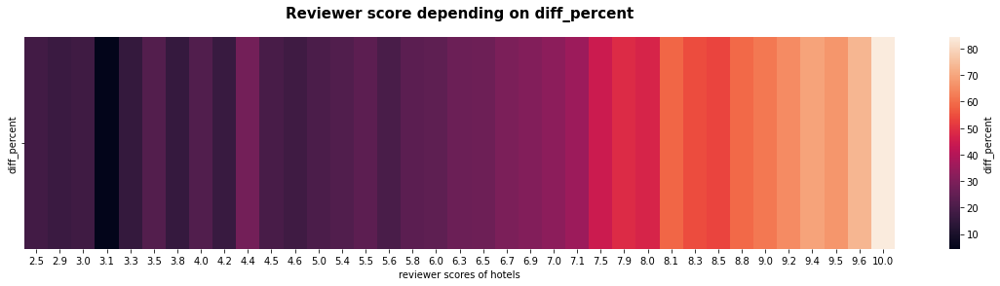

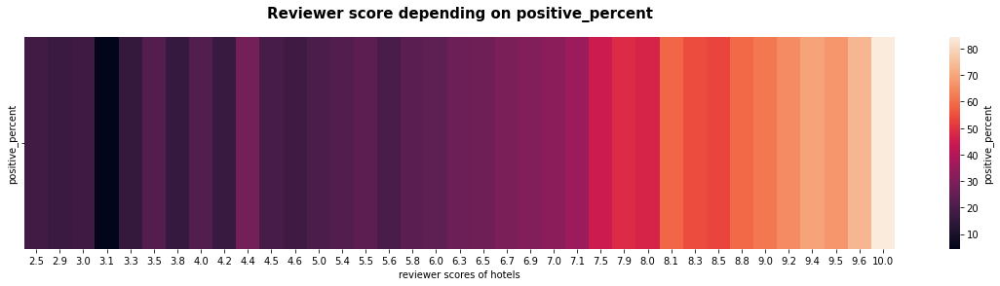

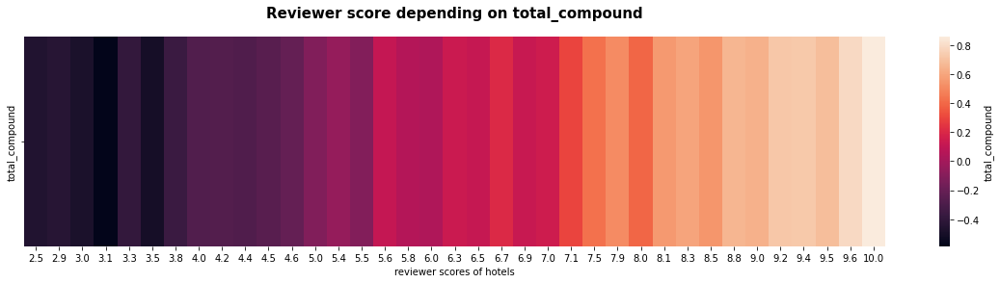

In [48]:
creating_heatmap(hotels, 'diff_percent', 'reviewer_score')
creating_heatmap(hotels, 'positive_percent', 'reviewer_score')
creating_heatmap(hotels, 'total_compound', 'reviewer_score')

Видна прямая зависимость оценок от настроения отзывов, процента позитивных слов в общем количество слов и разницы отрицательного и положительного количества слов

### Теги

Попробуем выделить отдельные признаки из тегов (признак *tags*):
* является ли поездка командировкой;
* есть ли животные;
* тип компании путешественников (например, семья с маленькми детьми/пара/компания друзей и т.д.)
* тип номера;
* количество ночей;

In [49]:
hotels['business_trip'] = hotels['tags'].apply(lambda x: 1 if 'Business trip' in x else 0)
hotels['with_pet'] = hotels['tags'].apply(lambda x: 1 if 'With a pet' in x else 0)
hotels['tags'] = hotels['tags'].apply(lambda x: x.replace("' Business trip ',", '').replace("' Leisure trip ',", '').replace("' With a pet ',", ''))
hotels['tags_list'] = hotels['tags'].apply(lambda x: x.replace('[', '').replace(']', '').split(" ', ' "))
hotels['company_type'] = hotels['tags_list'].apply(lambda x: x[0].replace("'", '').strip() if x else '')
hotels['room_type'] = hotels['tags_list'].apply(lambda x: x[1].strip() if len(x)>1 else '')
hotels['nights_count'] = hotels['tags_list'].apply(lambda x: int(x[2].strip()[7:9]) if len(x)>2 else 0)

In [50]:
df = hotels[hotels['sample']==1]
common_mean_score = round(df.reviewer_score.mean(), 2)
ser_pos = df['room_type'].str.lower().str.split()
words_list = []
for row in ser_pos:
    words_list.extend(row)
    
words = Counter(words_list)
words_dict = dict(sorted(words.items(), key=lambda item: item[1], reverse=True))
cnt = 1
bad_list = []
good_list = []
for word, _ in words_dict.items():
    if cnt == 150: 
        break
    
    mean_score  = round(df[df['room_type'].str.lower().str.contains(word)].reviewer_score.mean(), 2)
    if mean_score < common_mean_score-0.16:
        bad_list.append(word)
    elif mean_score > common_mean_score+0.16:
        good_list.append(word)
    cnt += 1
    
print(f'good words: {good_list}')
print(f'bad words: {bad_list}')

good words: ['king', 'classic', 'view', 'studio', 'city', 'luxury', 'terrace', 'large', 'premier', 'river', 'internal', 'courtyard', 'canal', 'dorsett', 'barlow', 'wing', 'garden', 'art', 'grand', 'floor', '4', 'annex', 'connecting', 'pool', 'ground', 'bridge', 'shard', 'shower', 'quality', 'stadium', 'kitchenette', 'prestige', 'people', 'royal', 'xl', 'camper', 'couch', 'corner', 'included', 'building', 'cozy']
bad words: ['standard', 'single', 'triple', 'hilton', 'non', 'smoking', 'and', 'basic', 'window', 'without', 'cosy', 'guestroom', '3', 'quadruple', 'economy', 'compact', 'to', 'no', 'bathroom', 'plus', 'from', '5', 'service', 'airport', 'shuttle', '00am', '00', '30am', 'penthouse', 'cabin', 'four', 'use', 'poster']


In [51]:
def get_room_type_manual(x):
    """Функция для определения типа номера вручную"""
    rooms_dict = [
        (4, ['luxury','premier', 'quality', 'prestige', 'large']),
        (3, ['King', 'suite', 'superior', 'deluxe', 'queen', 'premium', 'classic']),
        (2, ['rooms', 'two bedroom', 'club', 'comfort', 'family', 'spa', 'privilege', 'queen','studio', 'business', 'apartment', 'executive', 'double']),
        (1, ['economy', 'standard', 'twin', 'single', 'triple']),
    ]   
    x_lower = x.lower()
    for room_type_desc in rooms_dict:
        for room in room_type_desc[1]:
            if room in x_lower or room in x:
                return room_type_desc[0]                                 
    return 1

def get_room_type(x):
    """Функция для определения уровня номера по списку наиболее часто встречающихся слов"""
    words_list = x.lower().split()
    for good_word in good_list:
        if good_word in words_list:
            return 2
    for bad_word in bad_list:
        if bad_word in words_list:
            return 0
    return 1

def get_rooms_persons_count(x):
    """Функция для примерного определения количества человек, на которое рассчитан номер"""
    x_lower = x.lower()
    if 'double' in x_lower or 'twin' in x_lower:
        return 2
    if 'triple' in x_lower:
        return 3
    if 'single' in x_lower:
        return 1
    if 'family' in x_lower:
        return 4
    return 2

rooms_df = hotels.groupby('hotel_name', as_index=False)['room_type'].nunique()
rooms_df = rooms_df.rename(columns={'room_type': 'room_type_count'})

hotels = hotels.merge(rooms_df, how='left', on='hotel_name')
hotels['room_type_group'] = hotels['room_type'].apply(get_room_type)
hotels['room_type_group_manual'] = hotels['room_type'].apply(get_room_type_manual)
hotels['rooms_persons_count'] = hotels['room_type'].apply(get_rooms_persons_count)

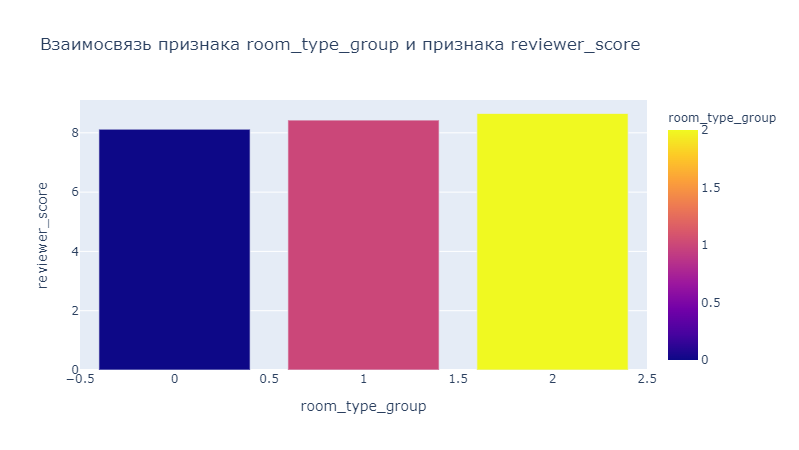

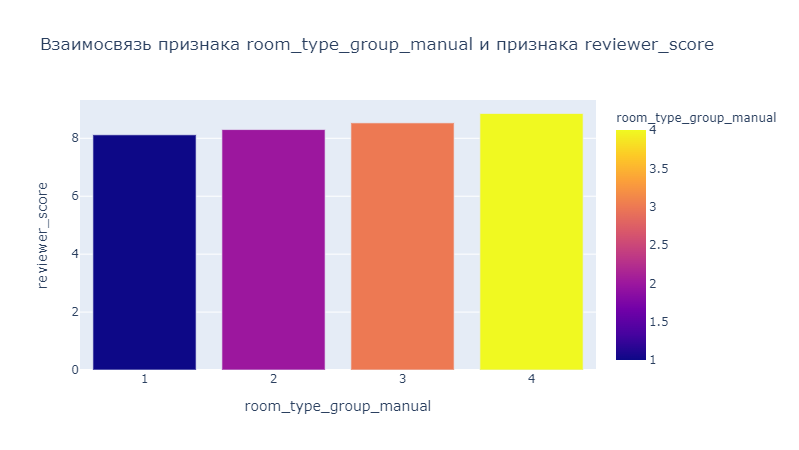

In [52]:
creating_bar(hotels, 'room_type_group', 'reviewer_score')
creating_bar(hotels, 'room_type_group_manual', 'reviewer_score')

Наблюдается небольшая прямая зависимость рейтинга от уровня номера

In [53]:
# кодируем тип компании путешественников
encoder = ce.OneHotEncoder(cols=['company_type'])
type_bin = encoder.fit_transform(hotels['company_type'])
type_bin = type_bin.rename(columns={'company_type_1':'Couple','company_type_2':'solo_traveler','company_type_3':'family_with_young_children','company_type_4':'group','company_type_5':'family_with_old_children','company_type_6':'travelers_with_friends'})
hotels = pd.concat([hotels, type_bin], axis=1)

## Анализ выбросов

In [54]:
#Объявляем функцию, реализующую фильтрацию выбросов по методу z-отклонений
def outliers_z_score(data, feature, log_scale=False):
    if log_scale:
        x = np.log(data[feature]+1)
    else:
        x = data[feature]
    mu = x.mean()
    sigma = x.std()
    lower_bound = mu - 3 * sigma
    upper_bound = mu + 3 * sigma
    outliers = data[(x < lower_bound) | (x > upper_bound)]
    cleaned = data[(x > lower_bound) & (x < upper_bound)]
    return outliers, cleaned

Построим гистограммы распределения для всех числовых признаков. Для удобства (чтобы сделать единообразно в цикле) построим также распределение логарифма признаков независимо от того, подходит ли он для конкретного признака.

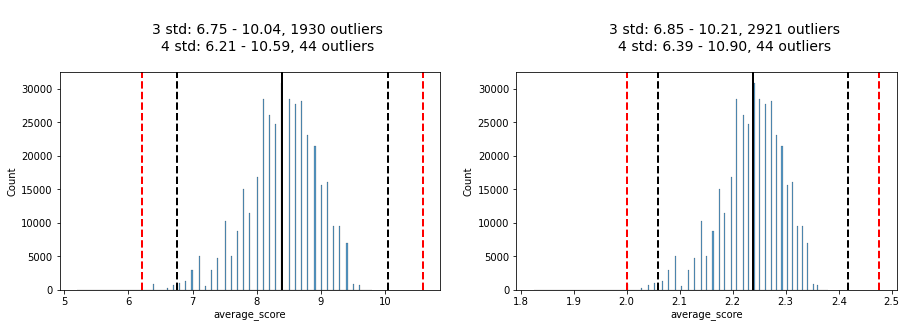

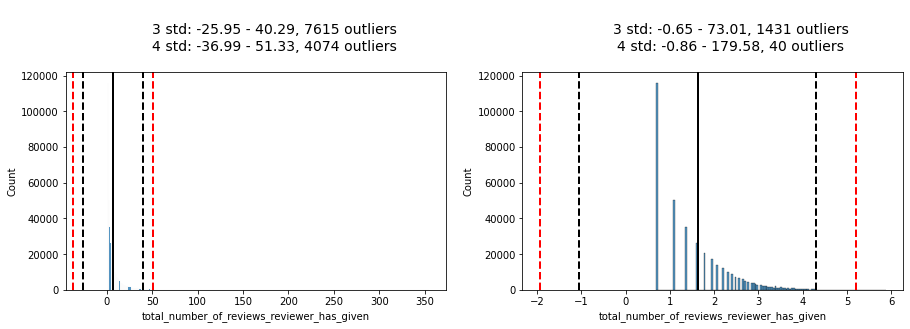

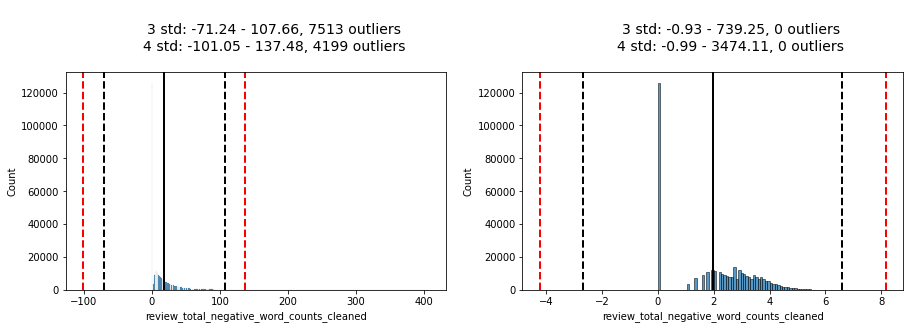

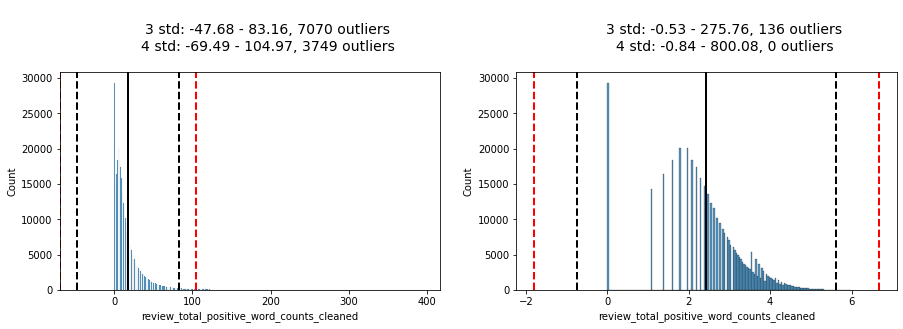

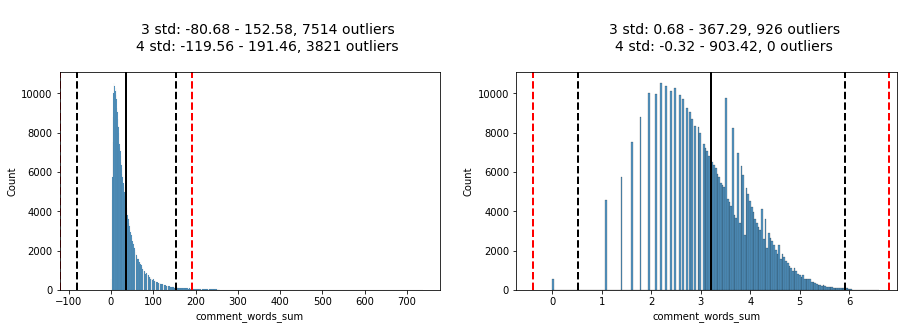

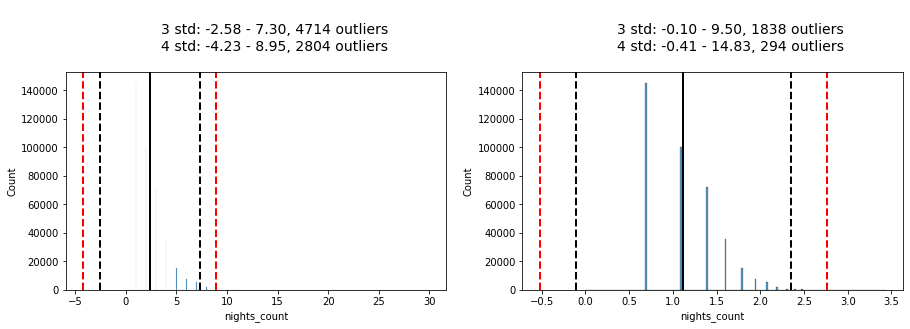

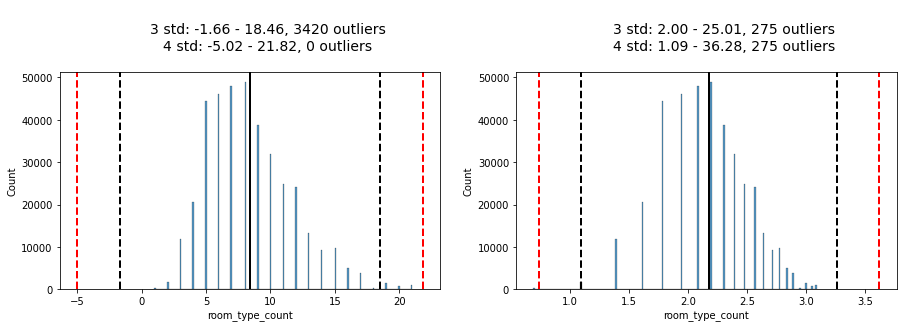

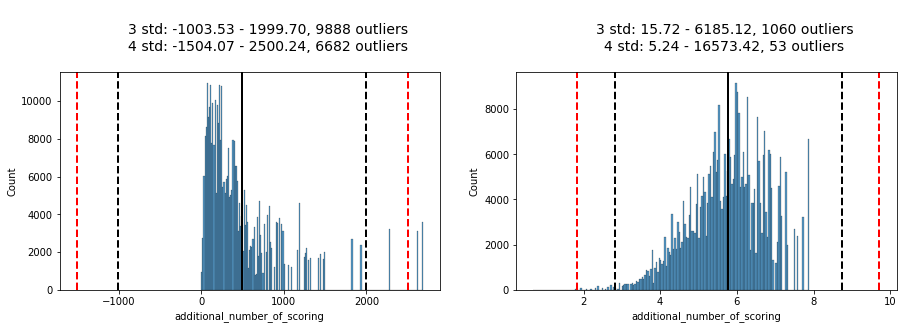

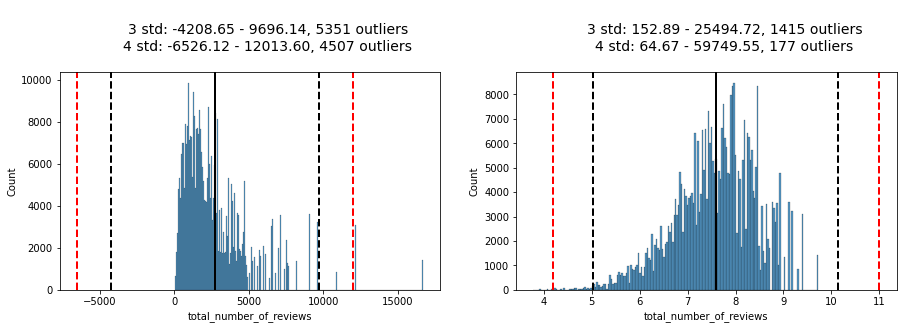

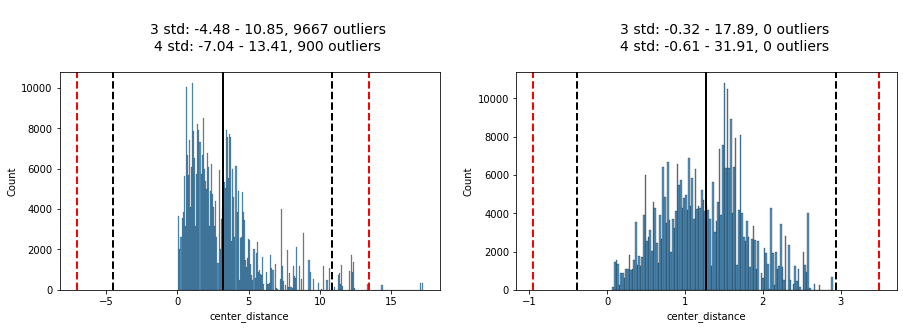

In [55]:
def histogram(feature, log_scale=False):
    #Строим гистограмму
    fig, axes = plt.subplots(1, 2, figsize=(15, 4))
    test_data =hotels[hotels['sample']==1] 
    
    hist1 = sns.histplot(data=test_data, x=feature, ax=axes[0]);
    feature_data = hotels[feature]
    #Добавляем вертикальные линии для среднего и 3ех стандартных отклонений влево и вправо от среднего
    feature_mean = feature_data.mean()
    feature_std = feature_data.std()
    lower_bound = feature_mean - 3*feature_data.std()
    upper_bound = feature_mean + 3*feature_data.std()
    lower_bound_2 = feature_mean - 4*feature_data.std()
    upper_bound_2 = feature_mean + 4*feature_data.std()
    axes[0].axvline(feature_mean, color='k', lw=2)
    axes[0].axvline(upper_bound, color='k', ls='--', lw=2)
    axes[0].axvline(lower_bound, color='k', ls='--', lw=2);
    axes[0].axvline(upper_bound_2, color='r', ls='--', lw=2)
    axes[0].axvline(lower_bound_2, color='r', ls='--', lw=2);
    
    rows_cnt = test_data[(test_data[feature] < lower_bound) | (test_data[feature] > upper_bound)].shape[0]
    rows_cnt_2 = test_data[(test_data[feature] < lower_bound_2) | (test_data[feature] > upper_bound_2)].shape[0]
    hist1.set_title(f"""
        3 std: {lower_bound:0.2f} - {upper_bound:0.2f}, {rows_cnt} outliers
        4 std: {lower_bound_2:0.2f} - {upper_bound_2:0.2f}, {rows_cnt_2} outliers
    """, fontsize=14)
    
    
    #Логарифмируем
    log_feature = np.log(test_data[feature]+1)
    #Строим гистограмму в логарифмическом масштабе
    hist2 = sns.histplot(data=log_feature, ax=axes[1]);
    #Добавляем вертикальные линии для среднего и 3ех стандартных отклонений влево и вправо от среднего
    log_mean = log_feature.mean()
    log_std = log_feature.std()
    log_lower_bound = log_mean - 3*log_std
    log_upper_bound = log_mean + 3*log_std
    log_lower_bound_2 = log_mean - 4*log_std
    log_upper_bound_2 = log_mean + 4*log_std
    axes[1].axvline(log_mean, color='k', lw=2)
    axes[1].axvline(log_lower_bound, color='k', ls='--', lw=2)
    axes[1].axvline(log_upper_bound, color='k', ls='--', lw=2);
    axes[1].axvline(log_lower_bound_2, color='r', ls='--', lw=2)
    axes[1].axvline(log_upper_bound_2, color='r', ls='--', lw=2);
    
    log_rows_cnt = test_data[(test_data[feature] < (np.exp(log_lower_bound)-1)) | (test_data[feature] > (np.exp(log_upper_bound)-1))].shape[0]
    log_rows_cnt_2 = test_data[(test_data[feature] < (np.exp(log_lower_bound_2)-1)) | (test_data[feature] > (np.exp(log_upper_bound_2)-1))].shape[0]
    hist2.set_title(f"""
        3 std: {np.exp(log_lower_bound)-1:0.2f} - {np.exp(log_upper_bound)-1:0.2f}, {log_rows_cnt} outliers
        4 std: {np.exp(log_lower_bound_2)-1:0.2f} - {np.exp(log_upper_bound_2)-1:0.2f}, {log_rows_cnt_2} outliers
    """, fontsize=14)
    

outliers_features = [
    'average_score', 'total_number_of_reviews_reviewer_has_given', 'review_total_negative_word_counts_cleaned', 'review_total_positive_word_counts_cleaned', 
    'comment_words_sum', 'nights_count', 'room_type_count', 'additional_number_of_scoring', 'total_number_of_reviews', 'center_distance'
]

for outliers_feature in outliers_features:
    histogram(outliers_feature, log_scale=False)

# histogram('average_score', log_scale=False)

Удалим из тестовой выборки строки, являющиеся выбросами. Однако некоторые границы смягчим.

In [56]:
cleaned_hotels = hotels[(hotels["average_score"]>=6.4) | (hotels['sample'] == 0)]
cleaned_hotels = cleaned_hotels[(cleaned_hotels["review_total_negative_word_counts_cleaned"]<=250) | (cleaned_hotels['sample'] == 0)]
cleaned_hotels = cleaned_hotels[(cleaned_hotels["review_total_positive_word_counts_cleaned"]<=250) | (cleaned_hotels['sample'] == 0)]
cleaned_hotels = cleaned_hotels[(cleaned_hotels["center_distance"]<14) | (cleaned_hotels['sample'] == 0)]
cleaned_hotels = cleaned_hotels[(cleaned_hotels['total_number_of_reviews_reviewer_has_given']<=100) | (cleaned_hotels['sample'] == 0)]
cleaned_hotels = cleaned_hotels[(cleaned_hotels["comment_words_sum"]<300) | (cleaned_hotels['sample'] == 0)]

print(f'Было: {hotels.shape[0]}, стало: {cleaned_hotels.shape[0]}')

Было: 515738, стало: 513186


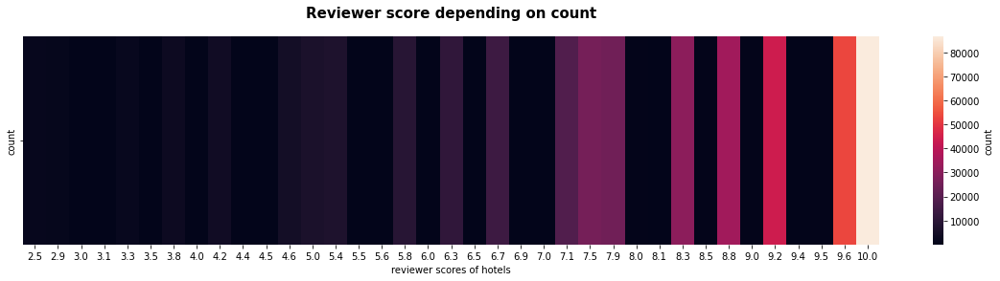

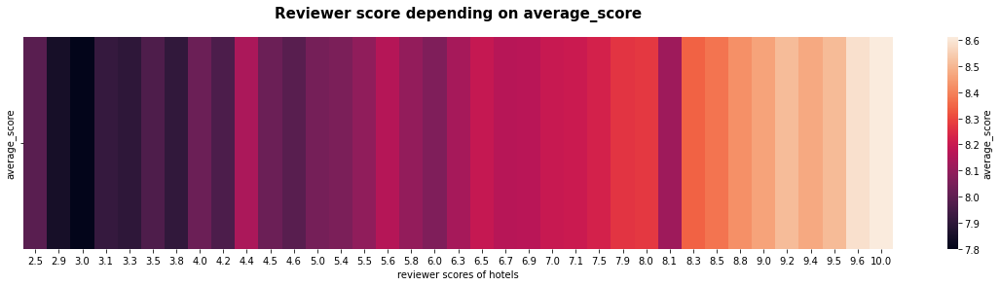

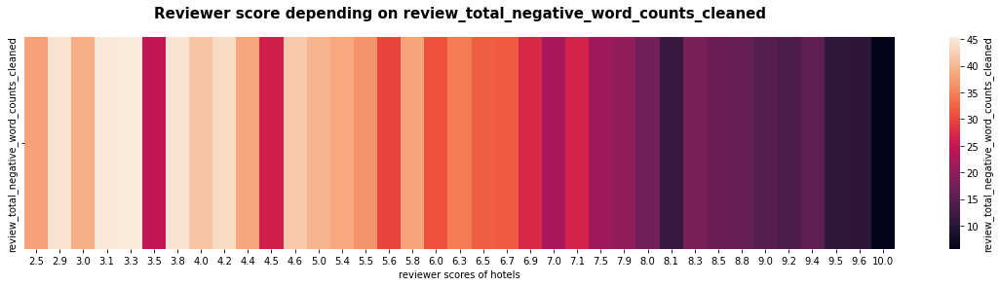

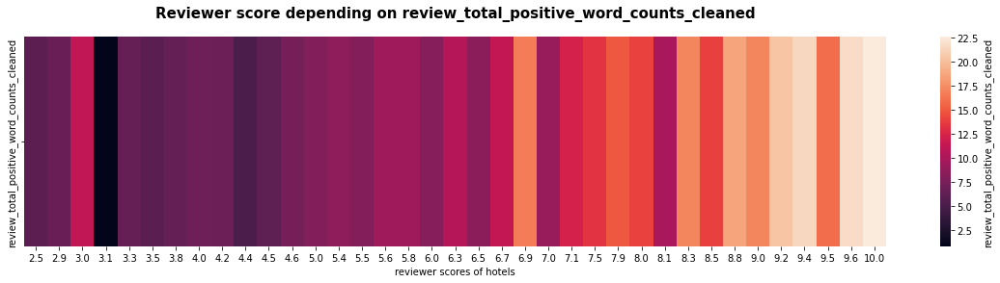

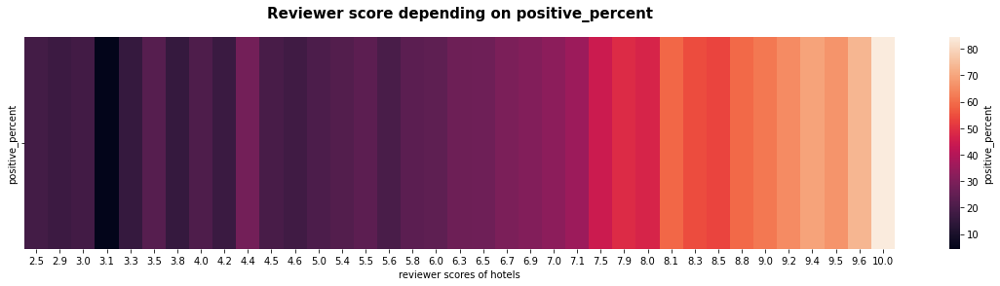

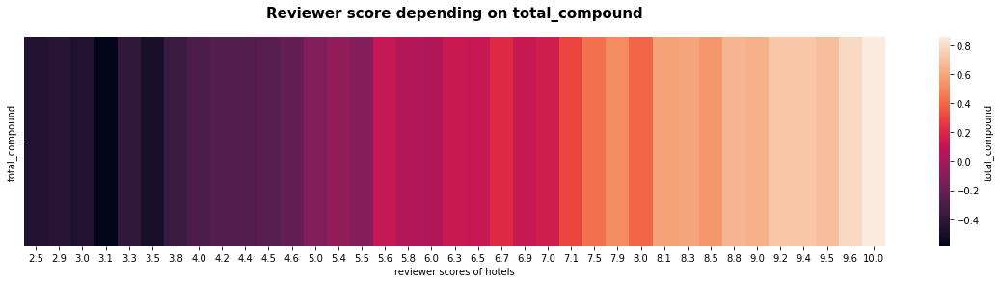

In [57]:
cleaned_hotels['count'] = 1
heatmap_negative = creating_heatmap(cleaned_hotels, 'count', 'reviewer_score', aggfunc='sum')
cleaned_hotels.drop(['count'], axis=1, inplace=True);
heatmap_negative = creating_heatmap(cleaned_hotels, 'average_score', 'reviewer_score')
heatmap_negative = creating_heatmap(cleaned_hotels, 'review_total_negative_word_counts_cleaned', 'reviewer_score')
heatmap_positive = creating_heatmap(cleaned_hotels, 'review_total_positive_word_counts_cleaned', 'reviewer_score')
heatmap_positive = creating_heatmap(cleaned_hotels, 'positive_percent', 'reviewer_score')
heatmap_positive = creating_heatmap(cleaned_hotels, 'total_compound', 'reviewer_score')

In [58]:
# рассчитаем частоту указания каждой оценки 
cleaned_hotels[cleaned_hotels['sample']==1].reviewer_score.value_counts()

10.0    86525
9.6     53296
9.2     43866
8.8     34624
8.3     30716
7.5     26015
7.9     24749
7.1     18383
6.7     13973
6.3     11123
5.8      8844
5.4      6971
5.0      6174
4.6      4565
4.2      3741
3.8      2927
3.3      1992
2.5      1567
2.9      1168
9.5       522
9.0       480
8.0       386
8.5       376
7.0       289
6.5       273
6.0       182
5.5       159
4.5        97
4.0        63
3.5        58
9.4        46
8.1        26
3.0        24
6.9        23
5.6        13
4.4         9
3.1         6
Name: reviewer_score, dtype: int64

Чтобы зависимость рейтинга и наиболее важных признаков была очевиднее, удалим редко встречающиеся оценки с аномальными значениями признаков. 

In [59]:
strange_scores = [3.0, 3.1, 3.5, 4.0, 4.4, 4.5, 5.5, 5.6, 6.0, 6.5, 6.9, 7.0, 8.0, 8.1, 8.5, 9.0, 9.4, 9.5]

cleaned_hotels = cleaned_hotels[(~cleaned_hotels["reviewer_score"].isin(strange_scores)) | (cleaned_hotels['sample'] == 0)]

print(f'Cтало: {cleaned_hotels.shape[0]}')

Cтало: 510154


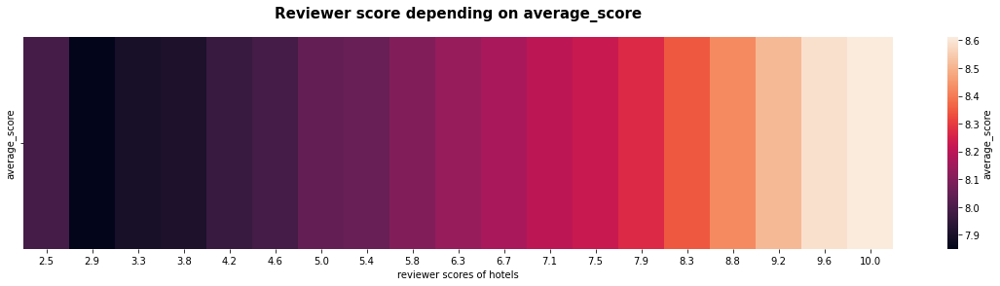

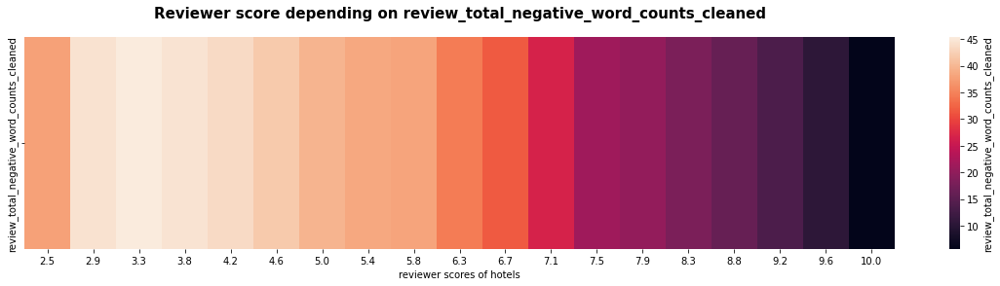

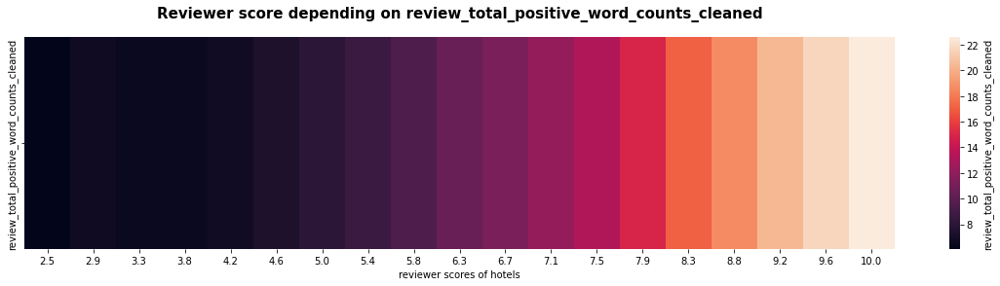

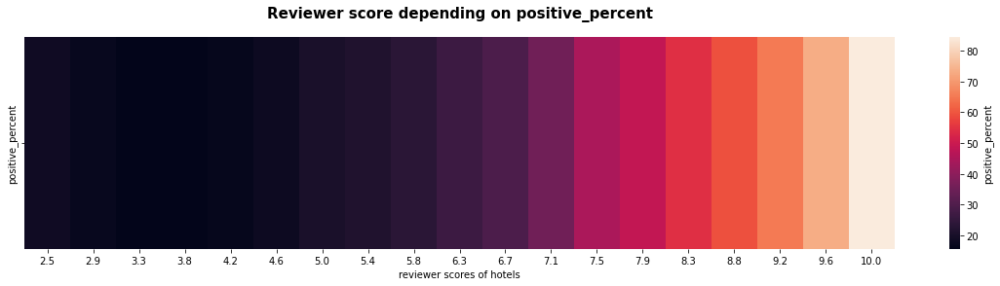

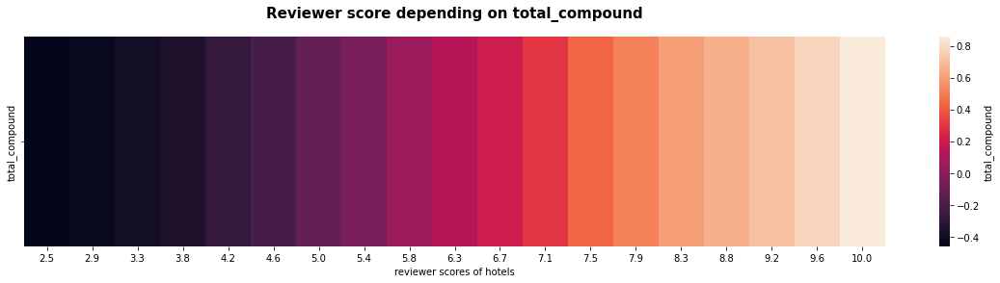

In [60]:
heatmap_negative = creating_heatmap(cleaned_hotels, 'average_score', 'reviewer_score')
heatmap_negative = creating_heatmap(cleaned_hotels, 'review_total_negative_word_counts_cleaned', 'reviewer_score')
heatmap_positive = creating_heatmap(cleaned_hotels, 'review_total_positive_word_counts_cleaned', 'reviewer_score')
heatmap_positive = creating_heatmap(cleaned_hotels, 'positive_percent', 'reviewer_score')
heatmap_positive = creating_heatmap(cleaned_hotels, 'total_compound', 'reviewer_score')

Взаимосвязь стала очевиднее

## Отбор признаков 

In [61]:
# убираем признаки которые еще не успели обработать, 
# модель на признаках с dtypes "object" обучаться не будет, просто выберем их и удалим
object_columns = [s for s in cleaned_hotels.columns if cleaned_hotels[s].dtypes == 'object']
cleaned_hotels.drop(object_columns, axis = 1, inplace=True)
cleaned_hotels = cleaned_hotels.fillna(0)

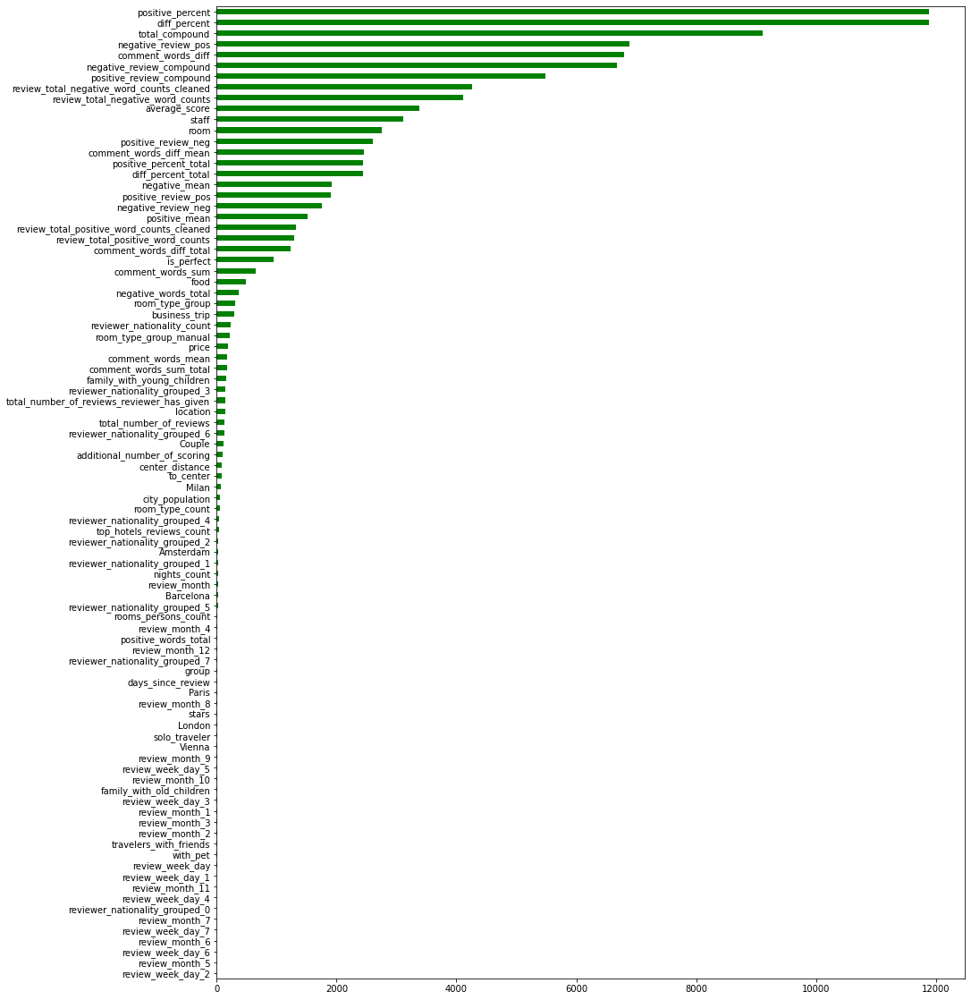

In [65]:
y_pre = cleaned_hotels.query('sample == 1').drop(['sample'], axis=1).reviewer_score.values
X_pre = cleaned_hotels.query('sample == 1').drop(['sample', 'reviewer_score'], axis=1)

imp_num = pd.Series(f_classif(X_pre[X_pre.columns], y_pre)[0], index = X_pre.columns)
imp_num.sort_values(inplace = True)

fig5, ax5 = plt.subplots(figsize=(15, 20))
imp_num.plot(kind = 'barh', color='green');

Пробовала удалить наименее значимые признаки, но метрика меняется в худшую сторону

<AxesSubplot:>

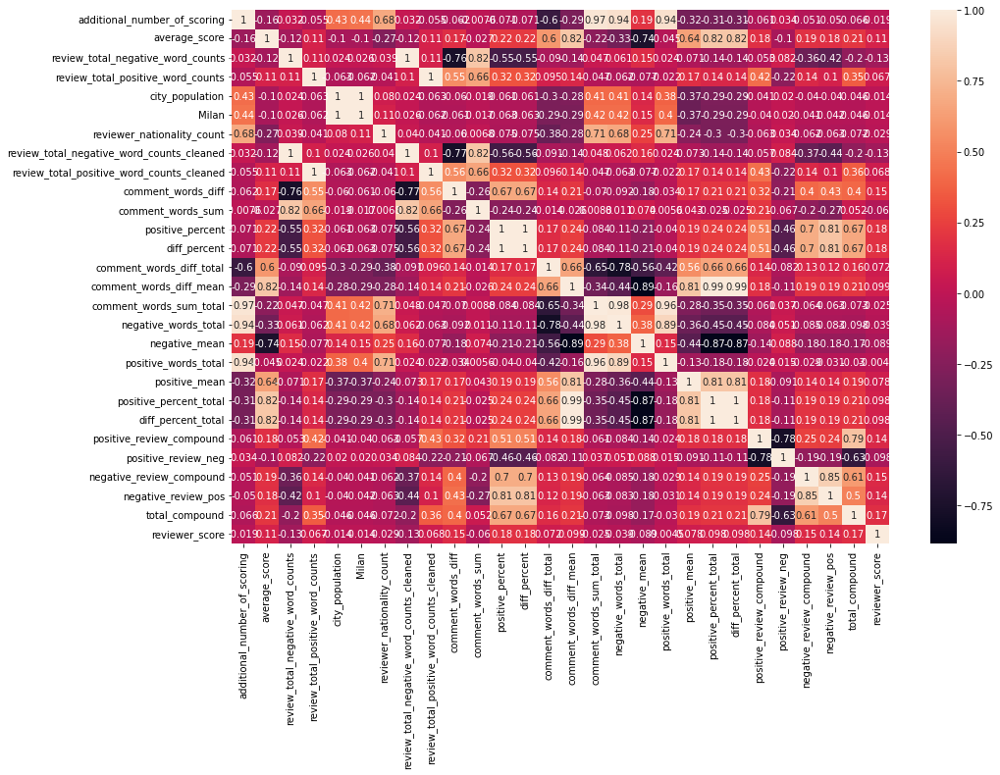

In [69]:
df_corr = cleaned_hotels.drop(['sample'], axis=1).corr()
result_columns = []
for column in df_corr:
    col_data = df_corr[column]
    if col_data.min() < -0.7 or col_data.sort_values(ascending=False)[1] > 0.7:
        result_columns.append(column)
result_columns.append('reviewer_score')
        
plt.rcParams['figure.figsize'] = (15,10)
sns.heatmap(cleaned_hotels[result_columns].corr(), annot=True)

In [70]:
cleaned_hotels.drop([
    'comment_words_sum_total',
    'negative_words_total',
    'positive_mean',
    'negative_mean',
    'comment_words_diff_mean',
    'positive_percent_total',
    'positive_words_total',
    'city_population',
    'additional_number_of_scoring',
    'review_total_negative_word_counts',
    'review_total_positive_word_counts',
    'total_number_of_reviews',
], axis=1, inplace=True);

Пробовала удалить все или часть коррелирующих признаков, оставив те, которые сильнее скоррелированы с зависимой переменной, но метрика изменяется в худшую сторону

<AxesSubplot:>

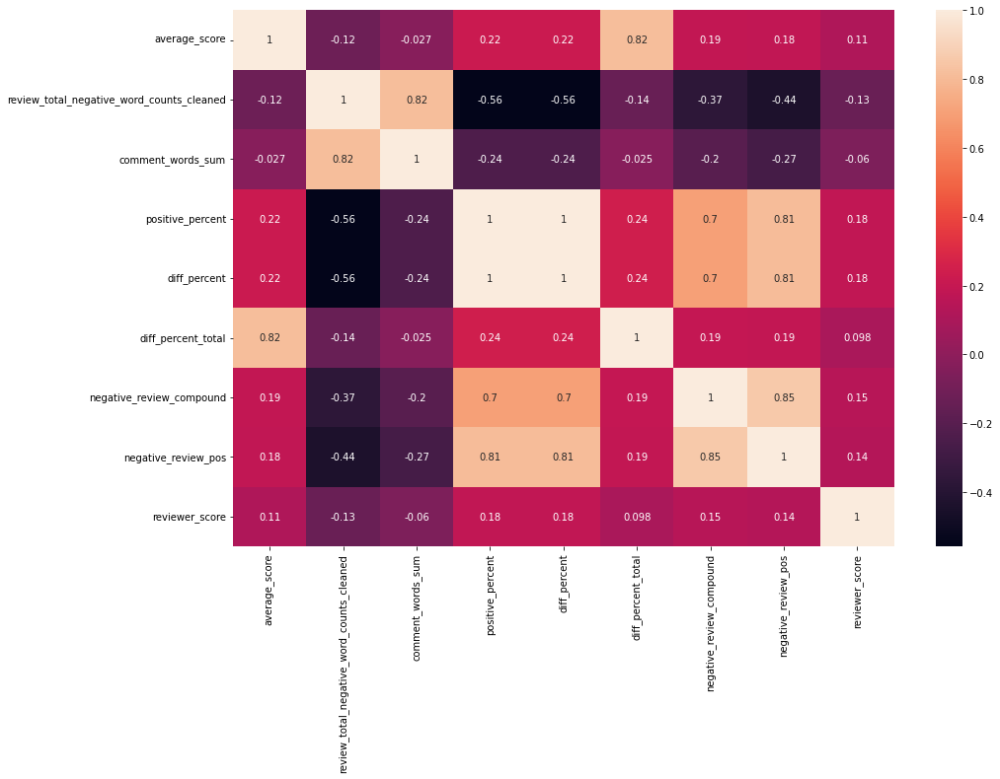

In [72]:
df_corr = cleaned_hotels.drop(['sample'], axis=1).corr()
result_columns = []
for column in df_corr:
    col_data = df_corr[column]
    if col_data.min() < -0.8 or col_data.sort_values(ascending=False)[1] > 0.8:
        result_columns.append(column)
result_columns.append('reviewer_score')
        
plt.rcParams['figure.figsize'] = (15,10)
sns.heatmap(cleaned_hotels[result_columns].corr(), annot=True)

Масштабирование не имеет смысла, метрика не улучшилась.

Это связано с тем, что RandomForestRegressor не чувствителен к масштабированию.

In [73]:
# Теперь выделим тестовую часть
train_data = cleaned_hotels.query('sample == 1').drop(['sample'], axis=1)
test_data = cleaned_hotels.query('sample == 0').drop(['sample'], axis=1)

y = train_data.reviewer_score.values            # наш таргет
X = train_data.drop(['reviewer_score'], axis=1)

# Воспользуемся специальной функцие train_test_split для разбивки тестовых данных
# выделим 20% данных на валидацию (параметр test_size)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=RANDOM_SEED)

# Создаём модель (НАСТРОЙКИ НЕ ТРОГАЕМ)
model = RandomForestRegressor(n_estimators=100, verbose=1, n_jobs=-1, random_state=RANDOM_SEED)

# Обучаем модель на тестовом наборе данных
model.fit(X_train, y_train)

# Используем обученную модель для предсказания рейтинга ресторанов в тестовой выборке.
# Предсказанные значения записываем в переменную y_pred
y_pred = model.predict(X_test)

[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:  2.6min
[Parallel(n_jobs=-1)]: Done 100 out of 100 | elapsed:  6.1min finished
[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    0.9s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    2.1s finished


In [74]:
from sklearn import metrics # инструменты для оценки точности модели 

def MAPE(y_true, y_pred): 
    y_true, y_pred = np.array(y_true), np.array(y_pred)
    return np.mean(np.abs((y_true - y_pred) / np.maximum(np.ones(len(y_true)), np.abs(y_true))))*100

print('MAPE:', MAPE(y_test, y_pred))

MAPE: 11.747309383136177


<AxesSubplot:>

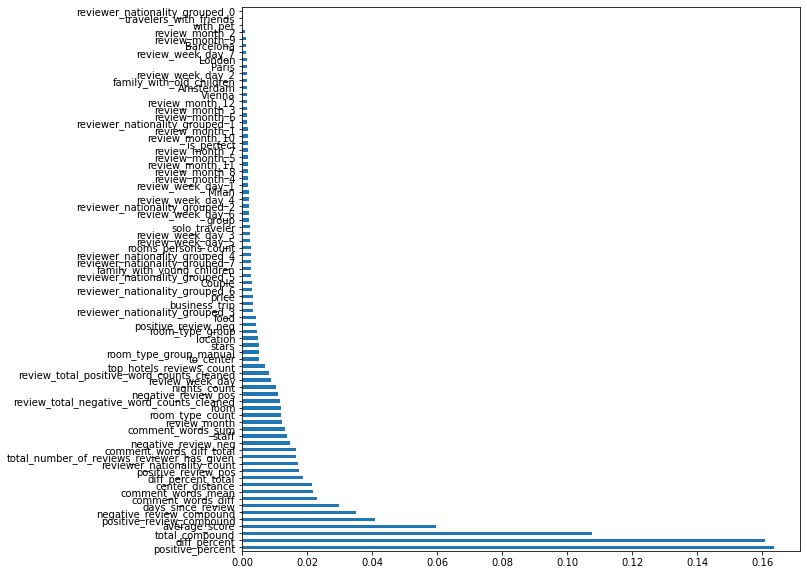

In [75]:
# в RandomForestRegressor есть возможность вывести самые важные признаки для модели
plt.rcParams['figure.figsize'] = (10,10)
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(90).plot(kind='barh')

In [76]:
test_data = test_data.drop(['reviewer_score'], axis=1)

predict_submission = model.predict(test_data)

[Parallel(n_jobs=4)]: Using backend ThreadingBackend with 4 concurrent workers.
[Parallel(n_jobs=4)]: Done  42 tasks      | elapsed:    1.5s
[Parallel(n_jobs=4)]: Done 100 out of 100 | elapsed:    3.6s finished


In [77]:
list(sample_submission)

sample_submission['reviewer_score'] = predict_submission
sample_submission.to_csv('submission.csv', index=False)
sample_submission.head(10)

,reviewer_score,id
0,8.680,488440
1,7.549,274649
2,8.038,374688
3,9.828,404352
4,9.690,451596
5,8.767,302161
6,7.868,317079
7,8.014,13963
8,8.552,159785
9,7.963,195089
